In [0]:

import pyspark
from pyspark.sql import SparkSession
from pyspark.sql.types import *
from pyspark.sql import functions as F
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
import numpy as np

from pyspark.ml.feature import StringIndexer, OneHotEncoder, VectorAssembler
from pyspark.ml.regression import RandomForestRegressor
from pyspark.ml import Pipeline
from pyspark.ml.evaluation import RegressionEvaluator
from pyspark.ml.feature import Tokenizer, Word2Vec
from pyspark.ml.regression import LinearRegression
from pyspark.ml.evaluation import RegressionEvaluator
from pyspark.sql.functions import col
from pyspark.ml.feature import StringIndexer, VectorAssembler
from pyspark.ml.regression import RandomForestRegressor
from pyspark.ml.feature import StringIndexer, OneHotEncoder

In [0]:
spark = SparkSession.builder.getOrCreate()

In [0]:
profiles = spark.read.parquet('/linkedin/people')

In [0]:
display(profiles)

about,avatar,certifications,city,country_code,current_company,current_company:company_id,current_company:name,education,educations_details,experience,followers,following,groups,id,languages,name,people_also_viewed,position,posts,recommendations,recommendations_count,timestamp,url,volunteer_experience,сourses
null,https://static.licdn.com/aero-v1/sc/h/244xhbkr7g40x6bsu4gi6q4ry,List(),"Sunnyside, Washington, United States",US,"List(sunnyside-unified-school-district, Sunnyside Unified School District, https://eg.linkedin.com/company/sunnyside-unified-school-district?trk=public_profile_topcard-current-company, Sunnyside Unified School District, Special Services Director at Sunnyside Unified School District)",sunnyside-unified-school-district,Sunnyside Unified School District,List(),null,"List(List(null, null, null, null, null, null, null, null, null, Sunnyside Unified School District, https://eg.linkedin.com/company/sunnyside-unified-school-district?trk=public_profile_experience-item_profile-section-card_subtitle-click, Special Services Director, null))",1,1,List(),cody-gardiner-7a039667,List(),cody gardiner,List(),Special Services Director at Sunnyside Unified School District,List(),List(),null,2023-09-04,https://www.linkedin.com/in/cody-gardiner-7a039667,List(),List()
null,https://static.licdn.com/aero-v1/sc/h/244xhbkr7g40x6bsu4gi6q4ry,List(),"Spring, Texas, United States",US,"List(null, N/A, null, N/A, Retired at N/A)",null,N/A,"List(List(Bachelor of Arts (BA), 1963, Elementary Education and Teaching, 1959 - 1963, 1959, Baylor University, https://www.linkedin.com/school/baylor-university/?trk=public_profile_school_profile-section-card_image-click))",Baylor University,"List(List(null, null, null, null, null, null, null, null, null, N/A, null, Retired, null))",13,13,List(),sharon-tunnell-436474104,List(),Sharon Tunnell,List(),Retired at N/A,List(),List(),null,2023-09-04,https://www.linkedin.com/in/sharon-tunnell-436474104,List(),List()
null,https://static.licdn.com/aero-v1/sc/h/244xhbkr7g40x6bsu4gi6q4ry,List(),United States,US,"List(null, null, null, null, --)",null,null,List(),null,List(),62,62,List(),teresa-fulford-25a59a4b,List(),Teresa Fulford,List(),--,List(),List(),null,2023-09-04,https://www.linkedin.com/in/teresa-fulford-25a59a4b,List(),List()
hard worker goal oriented and willing to work,https://static.licdn.com/aero-v1/sc/h/244xhbkr7g40x6bsu4gi6q4ry,List(),"Cleveland, Ohio, United States",US,"List(dfas, DFAS, https://cn.linkedin.com/company/dfas?trk=public_profile_topcard-current-company, DFAS, Military Pay Technician at DEFENSE FINANCE AND ACCOUNTING SERVICE-CLEVELAND Retired Annuitant Pay Cleveland Ohio)",dfas,DFAS,"List(List(null, 2005, null, 2004 - 2005 Received training in radio and television broadcast and production techniques. Skilled in operation of various audio and video studio equipment. Hands-on experience with Cool-Edit audio workstation. Practice with copy and news writing skills. Have maintained perfect attendance., 2004, OHIO CENTER FOR BROADCASTING, null), List(Bachelor of General Studies, 1999, General Studies of Art & Science, 1994 - 1999 Activities: Kent Interhall Council, Channels 45/49 Public Television, TV2, and Black United Students., 1994, Kent State University, https://cn.linkedin.com/school/kent-state-university/?trk=public_profile_school_profile-section-card_image-click))",OHIO CENTER FOR BROADCASTING,"List(List(DFAS, dfas, null, 14 years 8 months, null, null, null, List(List(Responsible for handling retired military pay accounts and answering the phone from Members, Annuitant and former spouse., Feb 2009 - Present 14 years 8 months, 14 years 8 months, Present, Feb 2009 - Present14 years 8 months , Responsible for handling retired military pay accounts and answering the phone from Members, Annuitant and former spouse., Feb 2009, DFAS, Military Pay Technician), List(Responsible for handling retired military pay accounts and answering the phone from Members, Annuitant and former spouse., Feb 2

## Making Assumptions to Understand Post Popularity

#### Recommendations

In [0]:
profiles.corr('followers', 'recommendations_count')

Out[8]: 0.04041692360137852

#### Posts Posted

In [0]:
profiles = profiles.select('followers', 'following', 'posts')

In [0]:
null_counts = [(col_name, profiles.filter(F.col(col_name).isNull()).count()) for col_name in profiles.columns]
display(null_counts)

_1,_2
followers,0
following,0
posts,0


In [0]:
no_posts_profiles = profiles.filter(F.expr("size(posts) == 0 and followers < 100000"))
posted = profiles.filter(F.expr("size(posts) > 0 and followers < 1000000"))

In [0]:
no_posts_profiles.corr('followers', 'following')

Out[12]: 1.0

In [0]:
summary_stats = no_posts_profiles.select('followers').describe()
summary_stats.show()

+-------+-----------------+
|summary|        followers|
+-------+-----------------+
|  count|          3424743|
|   mean|149.6387699748565|
| stddev|563.9006844804379|
|    min|                1|
|    max|            78000|
+-------+-----------------+



In [0]:
quartiles = no_posts_profiles.approxQuantile('followers', [0.25, 0.5, 0.75], 0.001)
q1, median, q3 = quartiles
print("Q1:", q1)
print("Median:", median)
print("Q3:", q3)

Q1: 2.0
Median: 12.0
Q3: 102.0


In [0]:
posted_stats = posted.select('followers').describe()
posted_stats.show()

+-------+-----------------+
|summary|        followers|
+-------+-----------------+
|  count|            37543|
|   mean|1826.935487307887|
| stddev|6618.885784646801|
|    min|                1|
|    max|           586000|
+-------+-----------------+



In [0]:
quartiles = posted.approxQuantile('followers', [0.25, 0.5, 0.75], 0.001)
q1, median, q3 = quartiles
print("Q1:", q1)
print("Median:", median)
print("Q3:", q3)

Q1: 316.0
Median: 786.0
Q3: 2000.0


#### Companies Worked At

In [0]:
profiles = spark.read.parquet('/linkedin/people')
company_names = profiles.select(F.expr("current_company.name").alias("company_name"), "followers").na.drop()
name_value_counts = company_names.groupBy('company_name').agg({"followers": "avg", "company_name": "count"})
name_value_counts = name_value_counts.filter("count(company_name) > 10")
name_value_counts = name_value_counts.orderBy(F.col("avg(followers)").desc())
display(name_value_counts)

company_name,avg(followers),count(company_name)
MSNBC,9716.818181818182,11
Turo,7372.625,16
Microsoft,5911.386164171399,1937
Jobot,5770.2307692307695,13
"IDC Technologies, Inc.",4535.733333333334,15
CommerceIQ,4391.533333333334,15
Stealth Mode,3898.7,20
Concordia University Irvine,3547.5384615384614,13
Tandym Group,3425.75,12
AdAdapted,3358.2727272727275,11


In [0]:
no_posts_profiles = profiles.filter(F.expr("size(posts) == 0 and followers < 100000"))
posted = profiles.filter(F.expr("size(posts) > 0 and followers < 1000000"))
company_names = no_posts_profiles.select(F.expr("current_company.name").alias("company_name"), "followers").na.drop()
name_value_counts = company_names.groupBy('company_name').agg({"followers": "avg", "company_name": "count"})
name_value_counts = name_value_counts.filter("count(company_name) > 5")
name_value_counts = name_value_counts.orderBy(F.col("avg(followers)").desc())
display(name_value_counts)

company_name,avg(followers),count(company_name)
Hirewell,7586.333333333333,6
TSP,5871.857142857143,7
Jobot,5770.2307692307695,13
Jebbit,5691.571428571428,7
UWorld,4908.166666666667,6
"CivicMinds, Inc",4720.0,6
"IDC Technologies, Inc.",4535.733333333334,15
DSI Security Services,4400.0,6
Remitly,4346.5,6
"American Public Education, Inc. (APEI)",4227.0,7


In [0]:
summary_stats = name_value_counts.select('avg(followers)').describe()
summary_stats.show()

+-------+------------------+
|summary|    avg(followers)|
+-------+------------------+
|  count|             33539|
|   mean| 216.6401548277905|
| stddev|284.88276265201904|
|    min|               1.0|
|    max| 7586.333333333333|
+-------+------------------+



In [0]:
quartiles = name_value_counts.approxQuantile('avg(followers)', [0.25, 0.5, 0.75], 0.001)
q1, median, q3 = quartiles
print("Q1:", q1)
print("Median:", median)
print("Q3:", q3)

Q1: 47.92779783393502
Median: 127.13333333333334
Q3: 278.5079365079365


In [0]:
company_names = posted.select(F.expr("current_company.name").alias("company_name"), "followers").na.drop()
name_value_counts = company_names.groupBy('company_name').agg({"followers": "avg", "company_name": "count"})
name_value_counts = name_value_counts.filter("count(company_name) > 10")
name_value_counts = name_value_counts.orderBy(F.col("avg(followers)").desc())
display(name_value_counts)

company_name,avg(followers),count(company_name)
Lockheed Martin,11666.307692307691,13
Cisco,4133.590909090909,22
Bank of America,3703.214285714286,14
LinkedIn,3646.5,16
Northwestern Mutual,2746.0,15
AT&T,2740.4210526315787,19
Douglas Elliman Real Estate,2563.090909090909,11
Northrop Grumman,2552.230769230769,13
Amazon Web Services (AWS),2517.0208333333335,48
Walmart,2307.037037037037,27


In [0]:
summary_stats = name_value_counts.select('avg(followers)').describe()
summary_stats.show()

+-------+------------------+
|summary|    avg(followers)|
+-------+------------------+
|  count|                60|
|   mean|1799.0207766922988|
| stddev|1511.0082725127857|
|    min|477.53846153846155|
|    max|11666.307692307691|
+-------+------------------+



In [0]:
quartiles = name_value_counts.approxQuantile('avg(followers)', [0.25, 0.5, 0.75], 0.001)
q1, median, q3 = quartiles
print("Q1:", q1)
print("Median:", median)
print("Q3:", q3)

Q1: 1032.5625
Median: 1538.3235294117646
Q3: 2057.6470588235293


#### Educational Institutions

In [0]:
profiles = spark.read.parquet('/linkedin/people')
edu_names = profiles.select(F.expr("educations_details").alias("institution"), "followers").na.drop()
edu_value_counts = edu_names.groupBy('institution').agg({"followers": "avg", "institution": "count"})
edu_value_counts = edu_value_counts.filter("count(institution) > 50")
edu_value_counts = edu_value_counts.orderBy(F.col("avg(followers)").desc())
display(edu_value_counts)

institution,count(institution),avg(followers)
The University of Chicago Booth School of Business,387,26951.754521963823
University of Alberta,100,2571.98
Harvard Business School,887,2408.34611048478
"University of Michigan College of Literature, Science, and the Arts",123,2216.4959349593496
INSEAD,83,1887.012048192771
California State University-Bakersfield,132,1839.3560606060605
Stanford University Graduate School of Business,361,1747.180055401662
"University of California, Berkeley - Walter A. Haas School of Business",73,1567.3835616438357
Massachusetts Institute of Technology - Sloan School of Management,121,1553.5454545454545
London Business School,80,1491.725


In [0]:
no_posts_profiles = profiles.filter(F.expr("size(posts) == 0 and followers < 100000"))
posted = profiles.filter(F.expr("size(posts) > 0 and followers < 1000000"))
edu_names = no_posts_profiles.select(F.expr("educations_details").alias("institution"), "followers").na.drop()
edu_value_counts = edu_names.groupBy('institution').agg({"followers": "avg", "institution": "count"})
edu_value_counts = edu_value_counts.filter("count(institution) > 50")
edu_value_counts = edu_value_counts.orderBy(F.col("avg(followers)").desc())
display(edu_value_counts)

institution,count(institution),avg(followers)
INSEAD,71,1529.887323943662
Stanford University Graduate School of Business,327,1367.6269113149847
Massachusetts Institute of Technology - Sloan School of Management,109,1326.302752293578
Harvard Business School,800,1308.88875
The University of Chicago - Booth School of Business,106,1277.301886792453
MIT Sloan School of Management,186,1237.752688172043
IE Business School,54,1234.2037037037037
"University of California, Los Angeles - The Anderson School of Management",52,1230.3076923076924
Columbia University - Columbia Business School,171,1207.0526315789473
Northwestern University - Kellogg School of Management,653,1202.5957120980092


In [0]:
summary_stats = edu_value_counts.select('avg(followers)').describe()
summary_stats.show()

+-------+-----------------+
|summary|   avg(followers)|
+-------+-----------------+
|  count|             3222|
|   mean|260.5520578581196|
| stddev|176.3948256801018|
|    min|18.03076923076923|
|    max|1529.887323943662|
+-------+-----------------+



In [0]:
quartiles = edu_value_counts.approxQuantile('avg(followers)', [0.25, 0.5, 0.75], 0.001)
q1, median, q3 = quartiles
print("Q1:", q1)
print("Median:", median)
print("Q3:", q3)

Q1: 139.10238095238094
Median: 218.92436974789916
Q3: 326.5194805194805


In [0]:
edu_names = posted.select(F.expr("educations_details").alias("institution"), "followers").na.drop()
edu_value_counts = edu_names.groupBy('institution').agg({"followers": "avg", "institution": "count"})
edu_value_counts = edu_value_counts.filter("count(institution) > 10")
edu_value_counts = edu_value_counts.orderBy(F.col("avg(followers)").desc())
display(edu_value_counts)

institution,count(institution),avg(followers)
Brown University,20,18662.35
University of Chicago,30,17117.633333333335
Harvard Business School,87,12518.298850574713
Yale Law School,11,10909.636363636364
Princeton University,14,9016.0
Lehigh University,18,7136.666666666667
Stanford University Graduate School of Business,34,5397.588235294118
University of Pennsylvania - The Wharton School,23,4946.304347826087
The Wharton School,40,4884.95
New York University - Leonard N. Stern School of Business,11,4749.909090909091


In [0]:
summary_stats = edu_value_counts.select('avg(followers)').describe()
summary_stats.show()

+-------+------------------+
|summary|    avg(followers)|
+-------+------------------+
|  count|               455|
|   mean| 1828.308604220139|
| stddev|1565.2990211330675|
|    min|             79.68|
|    max|          18662.35|
+-------+------------------+



In [0]:
quartiles = edu_value_counts.approxQuantile('avg(followers)', [0.25, 0.5, 0.75], 0.001)
q1, median, q3 = quartiles
print("Q1:", q1)
print("Median:", median)
print("Q3:", q3)

Q1: 1079.8076923076924
Median: 1502.1052631578948
Q3: 2079.6666666666665


#### Positions

In [0]:
profiles = spark.read.parquet('/linkedin/people')
profiles = profiles.withColumn("position", F.when(profiles["position"] == '--', None).otherwise(profiles["position"]))
profiles = profiles.withColumn("position", F.when(profiles["position"] == 'at', None).otherwise(profiles["position"]))
profiles = profiles.withColumn("position", F.when(profiles["position"] == '.', None).otherwise(profiles["position"]))
profiles = profiles.withColumn("position", F.lower(profiles["position"]))
pos_names = profiles.select("position", "followers").na.drop()
pos_value_counts = pos_names.groupBy('position').agg({"followers": "avg", "position": "count"})
pos_value_counts = pos_value_counts.filter("count(position) > 100")
pos_value_counts = pos_value_counts.orderBy(F.col("avg(followers)").desc())
display(pos_value_counts)

position,avg(followers),count(position)
technical recruiter,1226.0573770491803,122
managing director,950.6838235294117,136
business development manager,800.09243697479,238
chief operating officer,731.2936507936508,126
business development,697.0289855072464,207
recruiter,682.1244813278008,241
hr professional,682.0796460176991,113
chief executive officer,660.6237113402062,194
director of business development,653.0194174757281,103
customer success manager,559.9351851851852,108


In [0]:
no_posts_profiles = profiles.filter(F.expr("size(posts) == 0 and followers < 100000"))
posted = profiles.filter(F.expr("size(posts) > 0 and followers < 1000000"))
pos_names = no_posts_profiles.select("position", "followers").na.drop()
pos_value_counts = pos_names.groupBy('position').agg({"followers": "avg", "position": "count"})
pos_value_counts = pos_value_counts.filter("count(position) > 100")
pos_value_counts = pos_value_counts.orderBy(F.col("avg(followers)").desc())
display(pos_value_counts)

position,avg(followers),count(position)
technical recruiter,1207.4285714285713,119
managing director,808.608,125
business development manager,754.2532751091703,229
hr professional,684.697247706422,109
business development,662.6699507389162,203
recruiter,595.6694915254237,236
customer success manager,523.3301886792453,106
chief operating officer,522.9495798319327,119
software engineer at google,493.0267857142857,336
product manager,481.9945652173913,184


In [0]:
summary_stats = pos_value_counts.select('avg(followers)').describe()
summary_stats.show()

+-------+------------------+
|summary|    avg(followers)|
+-------+------------------+
|  count|               708|
|   mean| 87.13239890992914|
| stddev|115.49693329971277|
|    min| 4.314432989690721|
|    max|1207.4285714285713|
+-------+------------------+



In [0]:
quartiles = pos_value_counts.approxQuantile('avg(followers)', [0.25, 0.5, 0.75], 0.001)
q1, median, q3 = quartiles
print("Q1:", q1)
print("Median:", median)
print("Q3:", q3)

Q1: 19.328638497652584
Median: 38.74842767295598
Q3: 115.86262376237623


In [0]:
pos_names = posted.select("position", "followers").na.drop()
pos_value_counts = pos_names.groupBy('position').agg({"followers": "avg", "position": "count"})
pos_value_counts = pos_value_counts.filter("count(position) > 10")
pos_value_counts = pos_value_counts.orderBy(F.col("avg(followers)").desc())
display(pos_value_counts)

position,avg(followers),count(position)
managing director,2565.181818181818,11
general manager,2452.4545454545455,11
ceo,2131.714285714286,21
marketing manager,1793.0,11
entrepreneur,1629.5,20
consultant,1427.9473684210527,19
executive director,1250.6363636363637,11
real estate agent,1223.5454545454545,11
author,1175.764705882353,17
president,915.6875,16


In [0]:
summary_stats = pos_value_counts.select('avg(followers)').describe()
summary_stats.show()

+-------+------------------+
|summary|    avg(followers)|
+-------+------------------+
|  count|                21|
|   mean|1107.2386705479641|
| stddev| 664.4426649327899|
|    min| 451.1764705882353|
|    max| 2565.181818181818|
+-------+------------------+



In [0]:
quartiles = pos_value_counts.approxQuantile('avg(followers)', [0.25, 0.5, 0.75], 0.001)
q1, median, q3 = quartiles
print("Q1:", q1)
print("Median:", median)
print("Q3:", q3)

Q1: 587.5882352941177
Median: 856.1545454545454
Q3: 1427.9473684210527


#### Model for Feature Importance

In [0]:
profiles = spark.read.parquet('/linkedin/people')
profiles = profiles.select(F.expr("current_company.name").alias("company_name"), F.expr("educations_details").alias("institution"), "position", "followers").na.drop()
profiles = profiles.withColumn("position", F.when(profiles["position"] == '--', None).otherwise(profiles["position"]))
profiles = profiles.withColumn("position", F.when(profiles["position"] == 'at', None).otherwise(profiles["position"]))
profiles = profiles.withColumn("position", F.when(profiles["position"] == '.', None).otherwise(profiles["position"]))
profiles = profiles.withColumn("position", F.lower(profiles["position"]))
encoded_cols = []
for col_name in ['position', 'institution', 'company_name']:
    freq_map = profiles.groupBy(col_name).count().withColumnRenamed("count", f"{col_name}_freq")
    profiles = profiles.join(freq_map, on=col_name, how="left")
    encoded_cols.append(f"{col_name}_freq")
    profiles = profiles.na.drop()
assembler = VectorAssembler(inputCols=[*encoded_cols], outputCol="features")
rf = RandomForestRegressor(featuresCol="features", labelCol="followers")
pipeline = Pipeline(stages=[assembler, rf])
model = pipeline.fit(profiles)
predictions = model.transform(profiles)
evaluator = RegressionEvaluator(labelCol="followers", predictionCol="prediction", metricName="mse")
mse = evaluator.evaluate(predictions)
r2 = evaluator.evaluate(predictions, {evaluator.metricName: "r2"})

print(f"Mean Squared Error (MSE): {mse}")
print(f"R-squared (R2): {r2}")

feature_importance = model.stages[-1].featureImportances
print(feature_importance)

Mean Squared Error (MSE): 89674234.95300697
R-squared (R2): 0.00018684187484974135
(3,[0,1,2],[0.5982200960670319,0.2872384278003048,0.11454147613266318])


In [0]:
profiles = spark.read.parquet('/linkedin/people')
profiles = profiles.filter(F.expr("size(posts) == 0 and followers < 100000"))
profiles = profiles.select(F.expr("current_company.name").alias("company_name"), F.expr("educations_details").alias("institution"), "position", "followers").na.drop()
profiles = profiles.withColumn("position", F.when(profiles["position"] == '--', None).otherwise(profiles["position"]))
profiles = profiles.withColumn("position", F.when(profiles["position"] == 'at', None).otherwise(profiles["position"]))
profiles = profiles.withColumn("position", F.when(profiles["position"] == '.', None).otherwise(profiles["position"]))
profiles = profiles.withColumn("position", F.lower(profiles["position"]))
encoded_cols = []
for col_name in ['position', 'institution', 'company_name']:
    freq_map = profiles.groupBy(col_name).count().withColumnRenamed("count", f"{col_name}_freq")
    profiles = profiles.join(freq_map, on=col_name, how="left")
    encoded_cols.append(f"{col_name}_freq")
    profiles = profiles.na.drop()
assembler = VectorAssembler(inputCols=[*encoded_cols], outputCol="features")
rf = RandomForestRegressor(featuresCol="features", labelCol="followers")
pipeline = Pipeline(stages=[assembler, rf])
model = pipeline.fit(profiles)
predictions = model.transform(profiles)
evaluator = RegressionEvaluator(labelCol="followers", predictionCol="prediction", metricName="mse")
mse = evaluator.evaluate(predictions)
r2 = evaluator.evaluate(predictions, {evaluator.metricName: "r2"})

print(f"Mean Squared Error (MSE): {mse}")
print(f"R-squared (R2): {r2}")

feature_importance = model.stages[-1].featureImportances
print(feature_importance)

Mean Squared Error (MSE): 557814.1782787677
R-squared (R2): 0.007287857909013207
(3,[0,1,2],[0.4754708186740627,0.37666661661437534,0.14786256471156187])


In [0]:
profiles = spark.read.parquet('/linkedin/people')
profiles = profiles.filter(F.expr("size(posts) > 0 and followers < 10000000"))
profiles = profiles.select(F.expr("current_company.name").alias("company_name"), F.expr("educations_details").alias("institution"), "position", "followers").na.drop()
profiles = profiles.withColumn("position", F.when(profiles["position"] == '--', None).otherwise(profiles["position"]))
profiles = profiles.withColumn("position", F.when(profiles["position"] == 'at', None).otherwise(profiles["position"]))
profiles = profiles.withColumn("position", F.when(profiles["position"] == '.', None).otherwise(profiles["position"]))
profiles = profiles.withColumn("position", F.lower(profiles["position"]))
encoded_cols = []
for col_name in ['position', 'institution', 'company_name']:
    freq_map = profiles.groupBy(col_name).count().withColumnRenamed("count", f"{col_name}_freq")
    profiles = profiles.join(freq_map, on=col_name, how="left")
    encoded_cols.append(f"{col_name}_freq")
    profiles = profiles.na.drop()
assembler = VectorAssembler(inputCols=[*encoded_cols], outputCol="features")
rf = RandomForestRegressor(featuresCol="features", labelCol="followers")
pipeline = Pipeline(stages=[assembler, rf])
model = pipeline.fit(profiles)
predictions = model.transform(profiles)
evaluator = RegressionEvaluator(labelCol="followers", predictionCol="prediction", metricName="mse")
mse = evaluator.evaluate(predictions)
r2 = evaluator.evaluate(predictions, {evaluator.metricName: "r2"})

print(f"Mean Squared Error (MSE): {mse}")
print(f"R-squared (R2): {r2}")

feature_importance = model.stages[-1].featureImportances
print(feature_importance)

Mean Squared Error (MSE): 38220523.231740065
R-squared (R2): 0.0037296907827530923
(3,[0,1,2],[0.3111377089788595,0.3340509261686242,0.35481136485251624])


### Posts Explore

In [0]:
def follower_transform(followers):
    return (followers-12)/(0.007287857909*((0.418148*216.64)+(0.293135*260.55)+(0.288715*87.13)))

In [0]:
profiles = spark.read.parquet('/linkedin/people')
posted = profiles.filter(F.expr("size(posts) > 0 and followers < 10000000"))
posted = posted.withColumn("num_posts", F.size("posts"))
posted = posted.select("id", "posts", "followers", "about", "avatar", "current_company","education", "position")
transform_udf = udf(follower_transform, FloatType())
posted = posted.withColumn("followers_norm", transform_udf(posted["followers"]))
posted = posted.withColumn("followers_norm", F.when(posted["followers_norm"] < 0, 0).otherwise(posted["followers_norm"]))

In [0]:
posted = posted.withColumn("exploded_dict", F.explode("posts"))
posted = posted.select(
    "*",
    "exploded_dict.created_at",
    "exploded_dict.title",
    "exploded_dict.img"
).drop("exploded_dict", "posts")
stock = "https://static.licdn.com/aero-v1/scds/common/u/img/pic/pic_pulse_stock_article"
avatar = "https://static.licdn.com/aero-v1/sc/h/244xhbkr7g40x6bsu4gi6q4ry"
posted = posted.withColumn("stock_image", F.when(F.col("img").startswith(stock), 1).otherwise(0)).drop("img")
posted = posted.withColumn("stock_avatar", F.when(F.col("avatar").startswith(avatar), 1).otherwise(0)).drop("avatar")
posted = posted.withColumn("title_length", F.length("title"))

In [0]:
posted = posted.withColumn("is_employed", F.when(F.col("current_company.name").isNull(), 0).otherwise(1)).drop("current_company")
posted = posted.withColumn("is_educated", F.when(F.size("education") > 0, 1).otherwise(0))
posted = posted.withColumn("edu_num", F.size("education")).drop("education")

In [0]:
from pyspark.sql.functions import col, udf
from pyspark.sql.types import StringType, ArrayType, IntegerType

# Define lists of keywords for each category
education_keywords = ["education", "learn", "school", "student", "classroom", "teach", "study", "knowledge", "curriculum", "training", "university", "college", "academics", "lecturer", "degree", "academic", "research", "scholarship", "student", "academy"]
inspiration_keywords = ["inspire", "motivate", "encourage", "uplift", "inspiration", "empower", "positive", "success", "ambition", "hope", "encouragement", "motivation", "empowerment", "drive", "aspiration", "achievement", "perseverance", "optimism", "dream"]
science_tech_keywords = ["science", "technology", "innovation", "research", "tech", "engineering", "computer", "data", "experiment", "invention", "discovery", "development", "informatics", "scientific", "cyber", "biotechnology", "nanotechnology", "artificial intelligence", "robotics","ai","machine learning","ml","deep learning"]
work_keywords = ["work", "career", "job", "employment", "professional", "office", "business", "income", "opportunity", "resume", "#jobs", "hiring", "#hiring", "cv", "occupation", "job market", "workplace", "salary", "interview", "employee","hr"]


# Define a function to count words from each category in the text
def count_category_words(text):
    education_count = sum(1 for word in text.lower().split() if word in education_keywords)
    inspiration_count = sum(1 for word in text.lower().split() if word in inspiration_keywords)
    science_tech_count = sum(1 for word in text.lower().split() if word in science_tech_keywords)
    work_count = sum(1 for word in text.lower().split() if word in work_keywords)
    return [education_count, inspiration_count, science_tech_count, work_count]

# Create UDF to apply the counting function to the text column
count_category_words_udf = udf(count_category_words, ArrayType(IntegerType()))

# Apply the UDF to count words from each category
posted = posted.withColumn("category_counts", count_category_words_udf(col("title")))

# Define a function to classify text based on word counts
def classify_category_from_counts(counts):
    max_count = max(counts)
    if max_count == 0:
        return "General"
    elif max_count == counts[0]:
        return "Education & Self-Improvement"
    elif max_count == counts[1]:
        return "Inspiration"
    elif max_count == counts[2]:
        return "Science & Tech"
    else:
        return "Work"

classify_category_from_counts_udf = udf(classify_category_from_counts, StringType())
posted = posted.withColumn("category", classify_category_from_counts_udf(col("category_counts")))
posted=posted.drop("category_counts")
posted.display()

id,followers,about,position,followers_norm,created_at,title,stock_image,stock_avatar,title_length,is_employed,is_educated,edu_num,category
realjuldehball,36,null,Student at Lehman College,17.141134,2018-12-18T00:00:00.000Z,"Growing Up an American Muslim Army Brat, a Non-Fiction Memoir by Julde Halima Ball",0,1,82,0,1,2,General
bryan-johnson-ba-cadc-blueridge-balance-6ba23317,6000,"A National Interventionist since 2005 with a network associated to 400 treatment centers coast to coast. A graduate of DePaul University. Seasoned Strategic Executive Marketing Professional that includes creating Strategic Marketing Plans with 15 years of Data Driven Analysis for effective execution. Specializes working within Addiction Treatment Programs, Wilderness Treatment Programs, Extended Care & Sober Living Programs. Including Private Practice and Group Practices. Seasoned mental health practitioner with demonstrated track record of successfully working with diverse client populations in one-on-one and group settings. Life coach and Mentor Skilled at Motivating, Communicating and Advocating for clients dealing with substance abuse, mental health, and emotional disorders. Seventeen years of experience in Corporate America as Vice President of Sales & Marketing. Bryan works tirelessly to improve the standards of intervention treatment to ensure people in crisis get the care they both need and deserve. Pioneered, Developed , Marketed & Branded Urban Sober Living Program in Chicago known as ""Fresh Start Sober Living"" Pioneered, Developed, Marketed & Branded Country Model for Young Adult Male Extended Care Program known as ""Invictus Woods."" During tenure with DePaul University participated in researching sober living environments (specifically Oxford House) with grant funding provided by the “Center for Community Research” via NIDA/NIH directed by Dr. Leonard Jason. He is the co-founder of “Fresh Start Sober Living” Chicago, Illinois that has blossomed into a cluster of recovery homes located around the city. Attended St. Augustine College, Chicago, Illinois in Addiction Theory and Counseling. Certified Addictions Counselor and practiced for a large non-for-profit agency in Chicago specifically working with families in acute crisis. Organization has expanded and facilitates interventions for treatment centers located throughout the country. www.blueridgebalance.com Coming Summer 2023 BlueRidge Balance Professionals Group Boiling SpringsNC Specialties: Services: Bryan Johnson has been conducting interventions for over 17 years. He offers a wide variety of services before, during, and after treatment that meet your family's needs. * Intervention on Young Adults/Adolescents,and adults,Co-occurring Psychiatric Disorders and Trauma Survivors *Matching Patients to best Treatment Program *Court Liaison and Diversion *Safe Transportation and Escort Services *High Profile Interventions handled with Discretion *Intensive Case management","A Seasoned Interventionist of 17 years. Partner/ Founder ""BlueRidge Balance Adventure Retreats"" ""BlueRidge Balance Professionals Group"" Late Spring 2023",4276.713,2023-05-16T00:00:00.000Z,Healing Power of the Great Outdoors,0,0,35,1,1,2,General
jamesdoughertycpa,1000,"James P. Dougherty, CPA, CGMA is an assurance & advisory partner with JLK Rosenberger LLP and has 34+ years of A&A experience serving: manufacturers, wholesalers, service companies, charter schools, and nonprofits, property & casualty and life insurance companies. He also has experience with Single Audits under Uniform Guidance, higher education (colleges & universities), real estate investment fiduciaries (using NCREIF PREA Reporting Standards) and Employment Benefit Plan audits. James is one of the lead audit partners of the firms' nonprofit organization (NPO) practice and provides expert CFO services for NPO's and small businesses. James has developed within the firm, client accounting services (CAS) for a variety of businesses, such as professiona

In [0]:
posted = posted.na.drop()
tokenizer = Tokenizer(inputCol="about", outputCol="about_words")
posted = tokenizer.transform(posted)
word2vec = Word2Vec(vectorSize=30, minCount=5, inputCol="about_words", outputCol="about_embedded")
word2vec_model = word2vec.fit(posted)
posted = word2vec_model.transform(posted)

tokenizer2 = Tokenizer(inputCol="position", outputCol="position_words")
posted = tokenizer2.transform(posted)
word2vec2 = Word2Vec(vectorSize=30, minCount=5, inputCol="position_words", outputCol="position_embedded")
word2vec_model2 = word2vec2.fit(posted)
posted = word2vec_model2.transform(posted)

tokenizer3 = Tokenizer(inputCol="title", outputCol="title_words")
posted = tokenizer3.transform(posted)
word2vec3 = Word2Vec(vectorSize=30, minCount=5, inputCol="title_words", outputCol="title_embedded")
word2vec_model3 = word2vec3.fit(posted)
posted = word2vec_model3.transform(posted)

In [0]:
indexer_category = StringIndexer(inputCol="category", outputCol="category_index")
indexed_df = indexer_category.fit(posted).transform(posted)

feature_cols = ["category_index", "stock_image", 'stock_avatar', 'title_length', 'is_employed', 'is_educated', "edu_num", 'about_embedded', 'position_embedded', 'title_embedded']
assembler = VectorAssembler(inputCols=feature_cols, outputCol="features")
final_data = assembler.transform(indexed_df).select("features", col('followers_norm').cast("double").alias("label"))

In [0]:
train_data, test_data = final_data.randomSplit([0.8, 0.2], seed=123)

rf = RandomForestRegressor(featuresCol="features", labelCol="label")
rf_model = rf.fit(train_data)

lr = LinearRegression(featuresCol="features", labelCol="label")
lr_model = lr.fit(train_data)


predictions_rf = rf_model.transform(test_data)
predictions_lr = lr_model.transform(test_data)

# Evaluate Random Forest model
evaluator = RegressionEvaluator(labelCol='label', predictionCol='prediction', metricName='rmse')
rmse_rf = evaluator.evaluate(predictions_rf, {evaluator.metricName: "rmse"})
r2_rf = evaluator.evaluate(predictions_rf, {evaluator.metricName: "r2"})
mse_rf = evaluator.evaluate(predictions_rf, {evaluator.metricName: "mse"})

# Evaluate Linear Regression model
rmse_lr = evaluator.evaluate(predictions_lr, {evaluator.metricName: "rmse"})
r2_lr = evaluator.evaluate(predictions_lr, {evaluator.metricName: "r2"})
mse_lr = evaluator.evaluate(predictions_lr, {evaluator.metricName: "mse"})

# Print evaluation metrics for Linear Regression
print("Random Forest:")
print("Root Mean Squared Error (RMSE):", rmse_rf)
print("R-squared (R^2):", r2_rf)
print("Mean Squared Error (MSE):", mse_rf)

# Print evaluation metrics for Linear Regression
print("Linear Regression:")
print("Root Mean Squared Error (RMSE):", rmse_lr)
print("R-squared (R^2):", r2_lr)
print("Mean Squared Error (MSE):", mse_lr)

Random Forest:
Root Mean Squared Error (RMSE): 4588.30630171327
R-squared (R^2): 0.11395874351619151
Mean Squared Error (MSE): 21052554.7183417
Linear Regression:
Root Mean Squared Error (RMSE): 4780.786667521576
R-squared (R^2): 0.03806025568148286
Mean Squared Error (MSE): 22855921.160352062


####Visualizations & Analysis

In [0]:
posted.corr("title_length", "stock_image")

Out[49]: -0.09187634008287095

In [0]:
posted.corr("title_length", "followers")

Out[50]: 0.021083918642718448

In [0]:
posted.corr("stock_image", "followers")

Out[51]: -0.04009616435260702

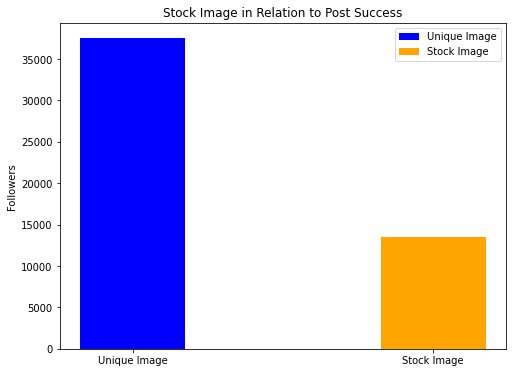

In [0]:
values = posted.select("stock_image").rdd.flatMap(lambda x: x).collect()
value_counts = dict()
for value in values:
    if value in value_counts:
        value_counts[value] += 1
    else:
        value_counts[value] = 1

plt.figure(figsize=(8, 6))

index = np.arange(len(value_counts))
bar_width = 0.35
colors = ['blue', 'orange']  # Colors for each value
labels = ['Unique Image', 'Stock Image']  # Labels for legend

for i, (value, count) in enumerate(value_counts.items()):
    plt.bar(i, count, bar_width, color=colors[i], label=labels[i])

plt.ylabel('Followers')
plt.title('Stock Image in Relation to Post Success')
plt.xticks(index, labels)
plt.legend()
plt.show()

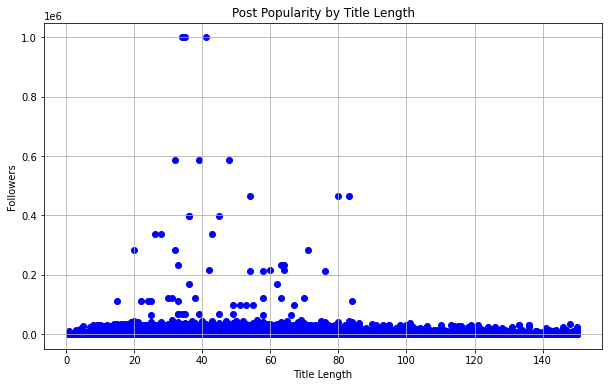

In [0]:
title_lengths = posted.select('title_length').rdd.flatMap(lambda x: x).collect()
followers = posted.select('followers').rdd.flatMap(lambda x: x).collect()
plt.figure(figsize=(10, 6))
plt.scatter(title_lengths, followers, color='blue')
plt.xlabel('Title Length')
plt.ylabel('Followers')
plt.title('Post Popularity by Title Length')
plt.grid(True)
plt.show()

In [0]:
posted_avgs = posted.groupBy('id').agg({"followers_norm": "avg", "title_length": "avg", "stock_image": "avg"})
display(posted_avgs)

id,avg(stock_image),avg(title_length),avg(followers_norm)
oausa1,0.5,30.5,219.97789001464844
sarahmchamberlain,0.0,26.0,545.6594848632812
james-balestraci-60003417,1.0,75.0,705.6433715820312
robertlack,1.0,42.0,621.3661499023438
hogiadikurniawan,0.0,32.0,243.5469512939453
lindadurbesson,0.3333333333333333,77.0,2848.28515625
prime6400,0.0,32.666666666666664,267.8302307128906
robertgreenbaum-mba,0.0,30.0,705.6433715820312
signe-pagel-b93549b,1.0,77.5,263.5449523925781
timcsimms,0.0,46.0,237.11903381347656


In [0]:
posted = posted.withColumn('created_at_date', F.to_date(F.col('created_at')))
avg_followers_per_day = posted.groupBy('created_at_date').avg('followers').orderBy('created_at_date')
avg_followers_per_day_pd = avg_followers_per_day.toPandas()

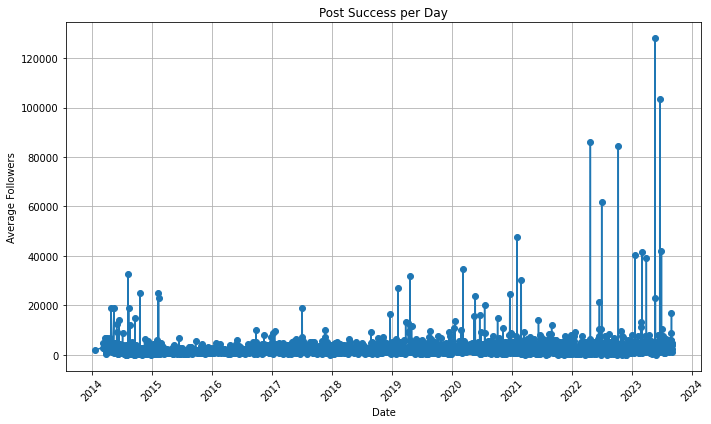

In [0]:
plt.figure(figsize=(10, 6))
plt.plot(avg_followers_per_day_pd['created_at_date'], avg_followers_per_day_pd['avg(followers)'], marker='o')
plt.title('Post Success per Day')
plt.xlabel('Date')
plt.ylabel('Average Followers')
plt.xticks(rotation=45)
plt.grid(True)
plt.tight_layout()
plt.show()

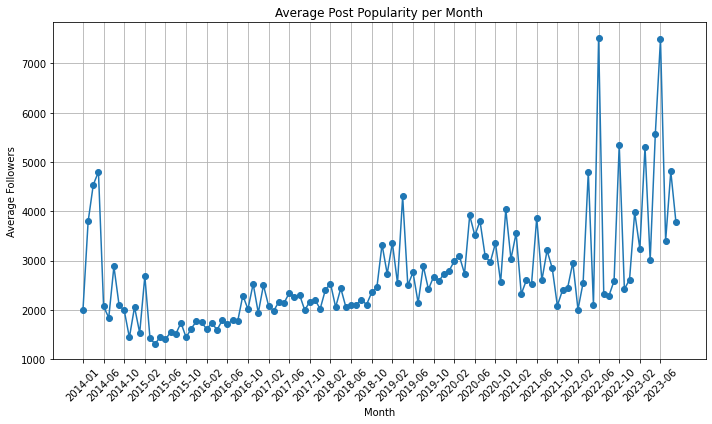

In [0]:
posted = posted.withColumn('created_at_month', F.date_format(F.to_date(F.col('created_at')), 'yyyy-MM'))
avg_followers_per_month = posted.groupBy('created_at_month').avg('followers').orderBy('created_at_month')
avg_followers_per_month_pd = avg_followers_per_month.toPandas()

plt.figure(figsize=(10, 6))
plt.plot(avg_followers_per_month_pd['created_at_month'], avg_followers_per_month_pd['avg(followers)'], marker='o')
plt.title('Average Post Popularity per Month')
plt.xlabel('Month')
plt.ylabel('Average Followers')
plt.xticks(rotation=45)
plt.xticks(avg_followers_per_month_pd['created_at_month'][::4])
plt.grid(True)
plt.tight_layout()
plt.show()

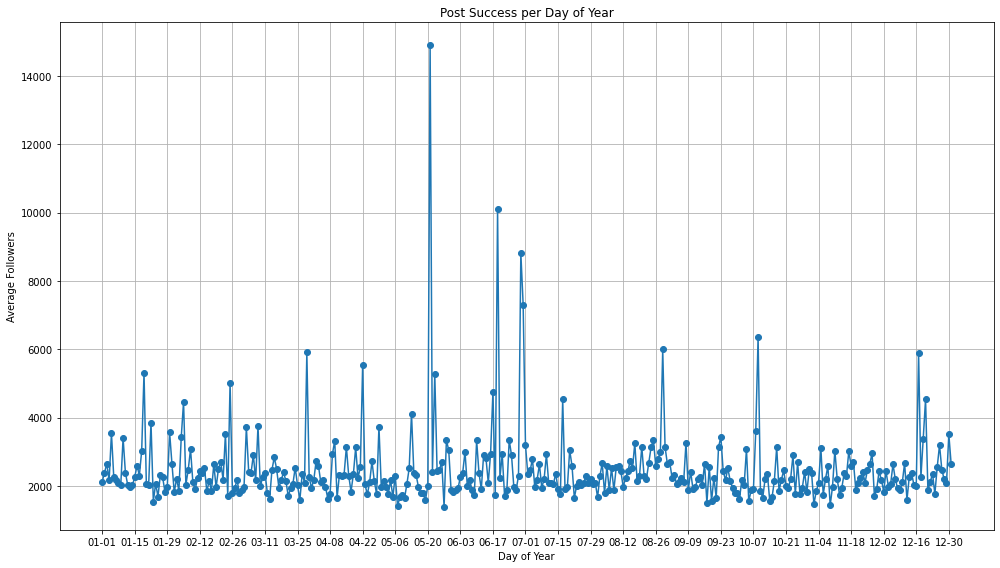

In [0]:
posted = posted.withColumn('day_of_year', F.date_format(F.to_date(F.col('created_at')), 'MM-dd'))
avg_followers_per_day_of_year = posted.groupBy('day_of_year').avg('followers').orderBy('day_of_year')
avg_followers_per_day_of_year_pd = avg_followers_per_day_of_year.toPandas()

plt.figure(figsize=(14, 8))
plt.plot(avg_followers_per_day_of_year_pd['day_of_year'], avg_followers_per_day_of_year_pd['avg(followers)'], marker='o')
plt.title('Post Success per Day of Year')
plt.xlabel('Day of Year')
plt.xticks(avg_followers_per_day_of_year_pd['day_of_year'][::14])
plt.ylabel('Average Followers')
plt.grid(True)
plt.tight_layout()
plt.show()

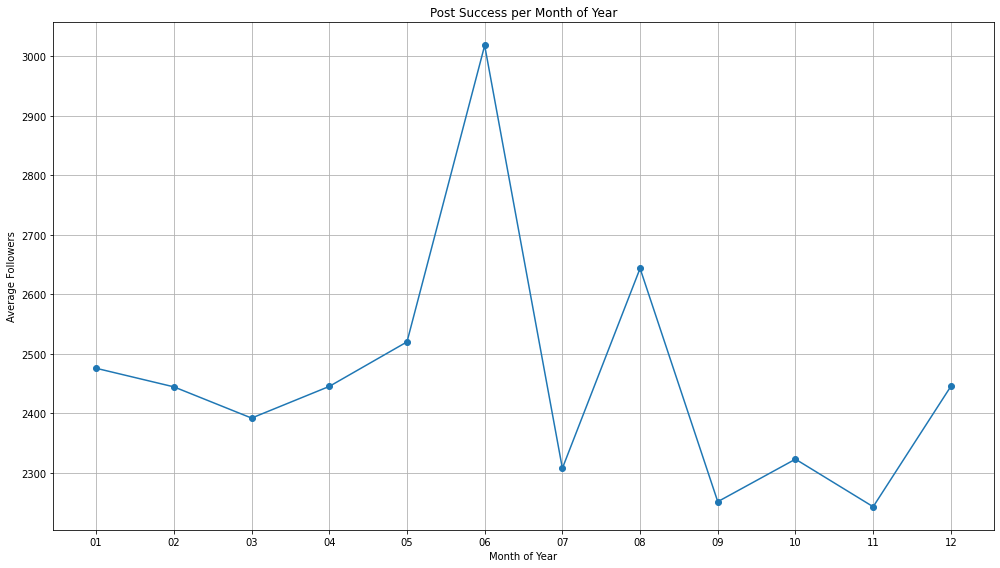

In [0]:
posted = posted.withColumn('month_of_year', F.date_format(F.to_date(F.col('created_at')), 'MM'))
avg_followers_per_day_of_year = posted.groupBy('month_of_year').avg('followers').orderBy('month_of_year')
avg_followers_per_day_of_year_pd = avg_followers_per_day_of_year.toPandas()

plt.figure(figsize=(14, 8))
plt.plot(avg_followers_per_day_of_year_pd['month_of_year'], avg_followers_per_day_of_year_pd['avg(followers)'], marker='o')
plt.title('Post Success per Month of Year')
plt.xlabel('Month of Year')
plt.ylabel('Average Followers')
plt.grid(True)
plt.tight_layout()
plt.show()

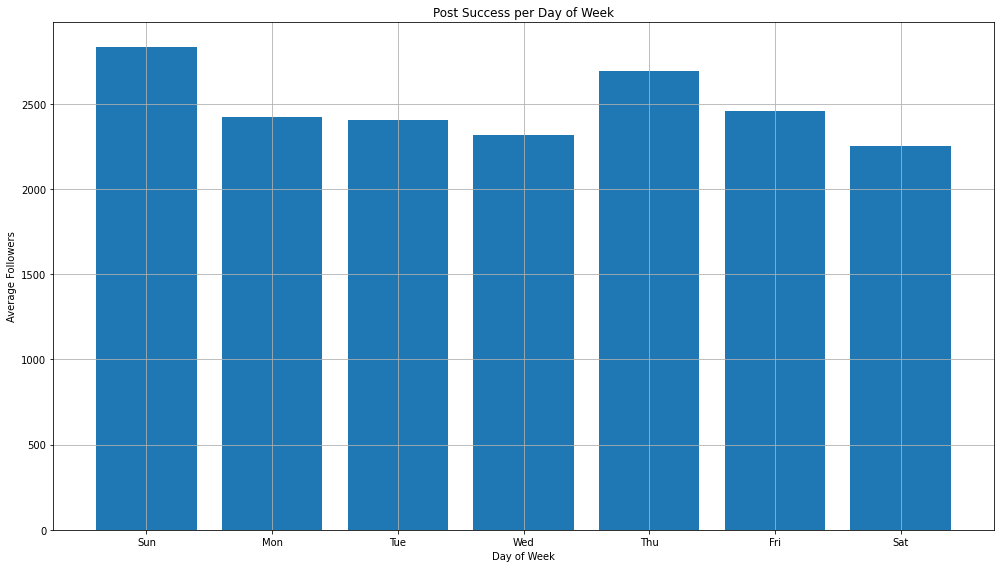

In [0]:
posted = posted.withColumn('day_of_week', F.date_format(F.to_date(F.col('created_at')), 'E'))
df_with_order = posted.groupBy('day_of_week').avg('followers')
df_with_order = df_with_order.withColumn('day_of_week_ordered', F.when(F.col('day_of_week') == 'Sun', 1).when(F.col('day_of_week') == 'Mon', 2).when(F.col('day_of_week') == 'Tue', 3).when(F.col('day_of_week') == 'Wed', 4).when(F.col('day_of_week') == 'Thu', 5).when(F.col('day_of_week') == 'Fri', 6).when(F.col('day_of_week') == 'Sat', 7))
df_with_order = df_with_order.orderBy('day_of_week_ordered')
df_with_order_pd = df_with_order.toPandas()

plt.figure(figsize=(14, 8))
plt.bar(df_with_order_pd['day_of_week'], df_with_order_pd['avg(followers)'])
plt.title('Post Success per Day of Week')
plt.xlabel('Day of Week')
plt.ylabel('Average Followers')
plt.grid(True)
plt.tight_layout()
plt.show()

In [0]:
display(posted)

id,followers,about,position,followers_norm,created_at,title,stock_image,stock_avatar,title_length,is_employed,is_educated,edu_num,category,about_words,about_embedded,position_words,position_embedded,title_words,title_embedded,created_at_date,created_at_month,day_of_year,month_of_year,day_of_week
bryan-johnson-ba-cadc-blueridge-balance-6ba23317,6000,"A National Interventionist since 2005 with a network associated to 400 treatment centers coast to coast. A graduate of DePaul University. Seasoned Strategic Executive Marketing Professional that includes creating Strategic Marketing Plans with 15 years of Data Driven Analysis for effective execution. Specializes working within Addiction Treatment Programs, Wilderness Treatment Programs, Extended Care & Sober Living Programs. Including Private Practice and Group Practices. Seasoned mental health practitioner with demonstrated track record of successfully working with diverse client populations in one-on-one and group settings. Life coach and Mentor Skilled at Motivating, Communicating and Advocating for clients dealing with substance abuse, mental health, and emotional disorders. Seventeen years of experience in Corporate America as Vice President of Sales & Marketing. Bryan works tirelessly to improve the standards of intervention treatment to ensure people in crisis get the care they both need and deserve. Pioneered, Developed , Marketed & Branded Urban Sober Living Program in Chicago known as ""Fresh Start Sober Living"" Pioneered, Developed, Marketed & Branded Country Model for Young Adult Male Extended Care Program known as ""Invictus Woods."" During tenure with DePaul University participated in researching sober living environments (specifically Oxford House) with grant funding provided by the “Center for Community Research” via NIDA/NIH directed by Dr. Leonard Jason. He is the co-founder of “Fresh Start Sober Living” Chicago, Illinois that has blossomed into a cluster of recovery homes located around the city. Attended St. Augustine College, Chicago, Illinois in Addiction Theory and Counseling. Certified Addictions Counselor and practiced for a large non-for-profit agency in Chicago specifically working with families in acute crisis. Organization has expanded and facilitates interventions for treatment centers located throughout the country. www.blueridgebalance.com Coming Summer 2023 BlueRidge Balance Professionals Group Boiling SpringsNC Specialties: Services: Bryan Johnson has been conducting interventions for over 17 years. He offers a wide variety of services before, during, and after treatment that meet your family's needs. * Intervention on Young Adults/Adolescents,and adults,Co-occurring Psychiatric Disorders and Trauma Survivors *Matching Patients to best Treatment Program *Court Liaison and Diversion *Safe Transportation and Escort Services *High Profile Interventions handled with Discretion *Intensive Case management","A Seasoned Interventionist of 17 years. Partner/ Founder ""BlueRidge Balance Adventure Retreats"" ""BlueRidge Balance Professionals Group"" Late Spring 2023",4276.713,2023-05-16T00:00:00.000Z,Healing Power of the Great Outdoors,0,0,35,1,1,2,General,"List(a, national, interventionist, since, 2005, with, a, network, associated, to, 400, treatment, centers, coast, to, coast., a, graduate, of, depaul, university., seasoned, strategic, executive, marketing, professional, that, includes, creating, strategic, marketing, plans, with, 15, years, of, data, driven, analysis, for, effective, execution., specializes, working, within, addiction, treatment, programs,, wilderness, treatment, programs,, extended, care, &, sober, living, programs., including, private, practice, and, group, practices., seasoned, mental, health, practitioner, with, demonstrated, track, record, of, successfully, working, with, diverse, client, populations, in, one-on-one, and, group, settings., life, coach, and, mentor, skilled, at, motivating,, communicating, and, advocating, for, clien